In [1]:
import torch
import pandas as pd
from torch import nn
from torchvision import transforms

from functools import partial

from collections import defaultdict



import re, math, sys
import numpy as np
import random

import os
from tqdm import tqdm

from PIL import Image
import importlib

from matplotlib import pyplot as plt

# model specific
from transformers import CLIPProcessor, CLIPModel


### Load data

In [2]:
stimuli_df = None
import utils
importlib.reload(utils)
stimuli_df = utils.STIMULI_DF

# add an extra "../" tot he data paths to create ../../VALSE_data
stimuli_df['img_path'] = [os.path.join("..",path) for path in stimuli_df['img_path']]

stimuli_df.head(2)


# import entire VALSE but only relevant linguistic phenomena
all_valse_df = utils.ENTIRE_DATASET_DF
all_valse_df = all_valse_df[all_valse_df['linguistic_phenomena'].isin(['actions','relations','existence'])]

# create 'img_path' column which has correct path to all the img files of valse dataset
all_valse_df['img_path'] = [os.path.join("../../VALSE_data/",path) for path in all_valse_df['local_img_path']]
all_valse_df.drop(['local_img_path'], axis=1)
all_valse_df.head(2)



/var/folders/3l/2lt99jp97mvbvsj3_p5hh8f80000gn/T/ipykernel_34741/1684243812.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  all_valse_df['img_path'] = [os.path.join("../../VALSE_data/",path) for path in all_valse_df['local_img_path']]


,dataset,dataset_idx,image_file,linguistic_phenomena,caption,answer,classes,split,original_split,classes_foil,...,key,declarative_statement,declarative_statement_foils,provenance_of_foils,foiling_method,orig_caption,only_caption,local_img_path,include_in_experiment,img_path
1000,coco2017,212732,000000462576.jpg,relations,Breakfast items including juice are on the table.,NaN,on,NaN,val,off,...,relations:coco_2017:212732,NaN,NaN,NaN,NaN,NaN,NaN,images/coco2017/000000462576.jpg,True,../../VALSE_data/images/coco2017/000000462576.jpg
1001,coco2017,528685,000000294162.jpg,relations,The white laptop is turned off but left open.,NaN,off,NaN,val,on,...,relations:coco_2017:528685,NaN,NaN,NaN,NaN,NaN,NaN,images/coco2017/000000294162.jpg,True,../../VALSE_data/images/coco2017/000000294162.jpg


### Load model

In [3]:
global model
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")
model_name = "CLIP"

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/_utils.py:776: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


In [4]:
processor

CLIPProcessor:
- image_processor: CLIPImageProcessor {
  "crop_size": {
    "height": 224,
    "width": 224
  },
  "do_center_crop": true,
  "do_convert_rgb": true,
  "do_normalize": true,
  "do_rescale": true,
  "do_resize": true,
  "image_mean": [
    0.48145466,
    0.4578275,
    0.40821073
  ],
  "image_processor_type": "CLIPImageProcessor",
  "image_std": [
    0.26862954,
    0.26130258,
    0.27577711
  ],
  "resample": 3,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "shortest_edge": 224
  }
}

- tokenizer: CLIPTokenizerFast(name_or_path='openai/clip-vit-base-patch32', vocab_size=49408, model_max_length=77, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<|startoftext|>', 'eos_token': '<|endoftext|>', 'unk_token': '<|endoftext|>', 'pad_token': '<|endoftext|>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	49406: AddedToken("<|startoftext|>", rstrip=False, lstrip=False, single_word=False, normalized=True, spe

### Define model prediction function (for SHAP -- taking list of images and caption/foil as input)

In [6]:
text_out = []

def model_predict(images, caption, foil):
    """Needs CAPTION and FOIL to be defined outside the function,
    they are kept constant within the function
    
    In practice SHAP will pass a SINGLE image in this step, so images = [image]"""

    global model

    processed = processor(text = [caption, foil],
                          images = images,
                          return_tensors = 'pt',
                          padding = True
                          )
    
    text_out.append(f"Processing SHAP with {caption} and {foil}")
    
    with torch.no_grad():
        outputs = model(**processed).logits_per_image # generatre logits for caption and foil for each image
        # Assuming the first score is for caption and second for foil
        score_diff = outputs[:, 0] - outputs[:, 1]  
    return score_diff.numpy() # this generates a caption-foil difference for each image in images

### Define model output caption for dataframes (taking dataframe as input)

Difference: the SHAP prediction function works with a list of images for a single set of captions. 

This one works with a dataframe where each SINGLE image is paired with one caption/foil and an output generated.

In [5]:
def model_output_dataframe(df):
    
    """Given a dataframe of images, captions, and foils, returns a dataframe of model outputs, one for each row in the dataframe"""

    results = defaultdict(list)

    for _, row in tqdm(df.iterrows()):

        # copy over those things that should be copied directly
        for name in ["img_path", "caption", "foil", "linguistic_phenomena"]:
            results[name].append(row[name])

        # prepare data point as inputs to test model on
        image = Image.open(row["img_path"])

        test_sentences = [row["caption"],
                        row["foil"]]
        
        # create CLIP input with BOTH captions
        try:
            inputs = processor(
                text = test_sentences,
                images = image,
                return_tensors = 'pt',
                padding = True
            )

        except:
            print(f"Trouble processing {row['img_path']}")
            continue
        
        clip_logits = model(**inputs).logits_per_image[0,0:2].tolist()
        clip_cap_foil_diff = clip_logits[0] - clip_logits[1]

        # save relevant fields to the dictionary to either {caption} or {foil} (based on which it is)
        results["model_pred_caption"].append(clip_logits[0]) # logit
        results["model_pred_foil"].append(clip_logits[1])
        results["model_pred_diff"].append(clip_cap_foil_diff)
    
    model_output = pd.DataFrame.from_dict(results)

    return model_output

### Generate model output for each data point in STIMULI dataframe (without maskng)

99it [00:08, 11.15it/s]


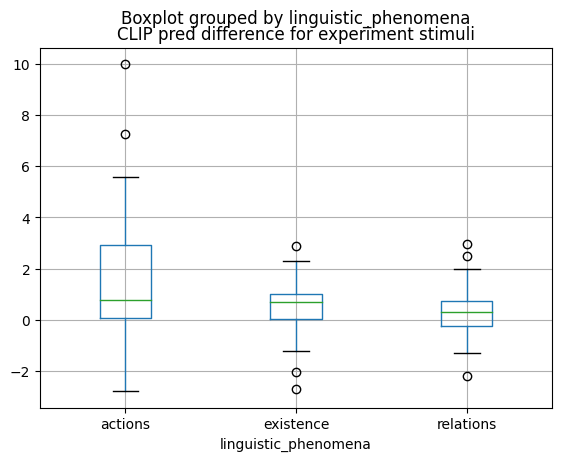

In [6]:

stimuli_output_df = model_output_dataframe(stimuli_df)

# export results
stimuli_output_df.to_pickle(f"xai_output/{model_name}_stimuli_output_scores.pickle")

# graph outcome
stimuli_output_df.boxplot(column='model_pred_diff', by='linguistic_phenomena')
plt.title(f"{model_name} pred difference for experiment stimuli")
plt.show()


### Generate model output for ENTIRE VALSE DATASET for 3 linguistic phenomena

Assuming  only for 3 phenomena

In [7]:
RUN_ON_WHOLE_DATASET = True # can be turned off when we don't need this

if RUN_ON_WHOLE_DATASET:

    valse_output_df = model_output_dataframe(all_valse_df)

    # export results
    valse_output_df.to_pickle(f"xai_output/{model_name}_all_of_valse_output_scores.pickle")

    # graph outcome
    valse_output_df.boxplot(column='model_pred_diff', by='linguistic_phenomena')
    plt.title(f"{model_name} pred difference for all of VALSE")
    plt.show()

782it [01:10, 11.06it/s]


KeyboardInterrupt: 

## Build SHAP pipeline

### Masking functions

In [ ]:
from shap_functions import vector_to_masked_images, blur_image


### Test masking

In [ ]:
# image = Image.open("../../VALSE_data/images/coco2017/000000122672.jpg")
# image = np.array(image.resize((224,224)))

# blurred_image = blur_image(image)

# test_mask_array = np.array([
#     [1, 0, 0, 1],
#     [0, 1, 1, 0],
#     [1, 0, 0, 0],
#     [0, 0, 1, 0]
# ])

# masked_img = vector_to_masked_images([test_mask_array], image, blurred_image, N_ROWS=4)[0]
# plt.imshow(masked_img)

### SHAP function

In [5]:
import shap_functions
importlib.reload(shap_functions)

<module 'shap_functions' from '/Users/eduardsaakashvili/Desktop/UU/Thesis/code/es-thesis-repo/data/xai_maps/shap_functions.py'>

# Export SHAP maps

Processing stimulus 1 out of 99
Processing stimulus 2 out of 99
Processing stimulus 3 out of 99
Processing stimulus 4 out of 99
Processing stimulus 5 out of 99
Processing stimulus 6 out of 99
Processing stimulus 7 out of 99
Processing stimulus 8 out of 99
Processing stimulus 9 out of 99
Processing stimulus 10 out of 99
Processing stimulus 11 out of 99
Processing stimulus 12 out of 99
Processing stimulus 13 out of 99
Processing stimulus 14 out of 99
Processing stimulus 15 out of 99
Processing stimulus 16 out of 99
Processing stimulus 17 out of 99
Processing stimulus 18 out of 99
Processing stimulus 19 out of 99
Processing stimulus 20 out of 99


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.


Processing stimulus 21 out of 99


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.


Processing stimulus 22 out of 99
Processing stimulus 23 out of 99
Processing stimulus 24 out of 99
Processing stimulus 25 out of 99
Processing stimulus 26 out of 99
Processing stimulus 27 out of 99
Processing stimulus 28 out of 99
Processing stimulus 29 out of 99
Processing stimulus 30 out of 99
Processing stimulus 31 out of 99
Processing stimulus 32 out of 99
Processing stimulus 33 out of 99
Processing stimulus 34 out of 99
Processing stimulus 35 out of 99
Processing stimulus 36 out of 99
Processing stimulus 37 out of 99
Processing stimulus 38 out of 99
Processing stimulus 39 out of 99
Processing stimulus 40 out of 99
Processing stimulus 41 out of 99
Processing stimulus 42 out of 99
Processing stimulus 43 out of 99
Processing stimulus 44 out of 99
Processing stimulus 45 out of 99
Processing stimulus 46 out of 99
Processing stimulus 47 out of 99
Processing stimulus 48 out of 99
Processing stimulus 49 out of 99
Processing stimulus 50 out of 99
Processing stimulus 51 out of 99
Processing

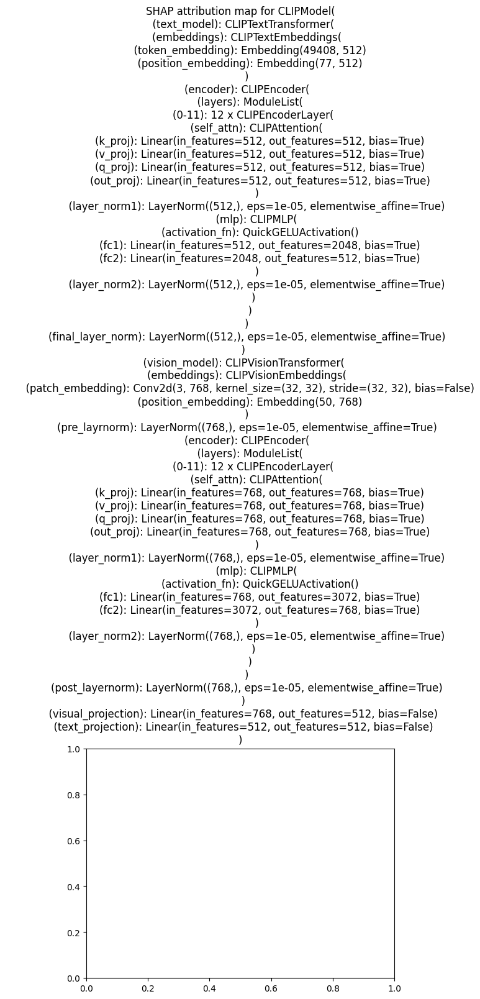

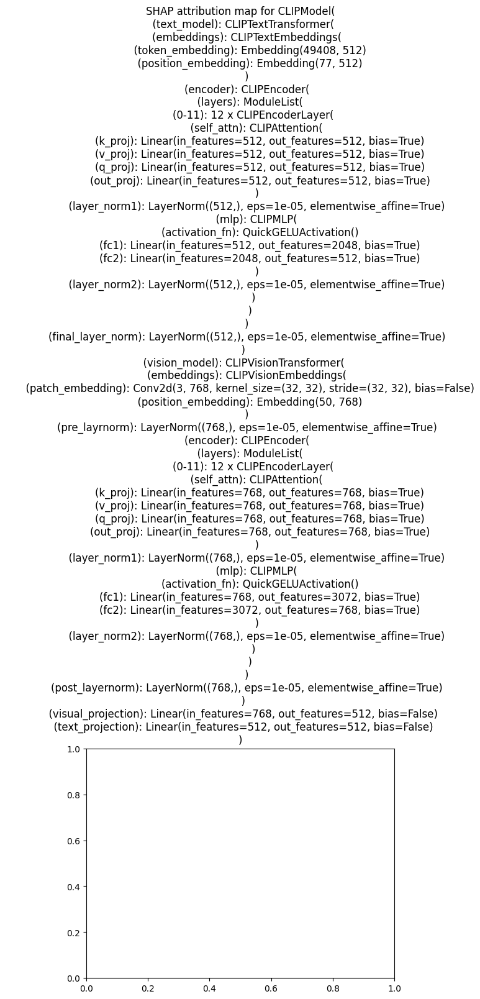

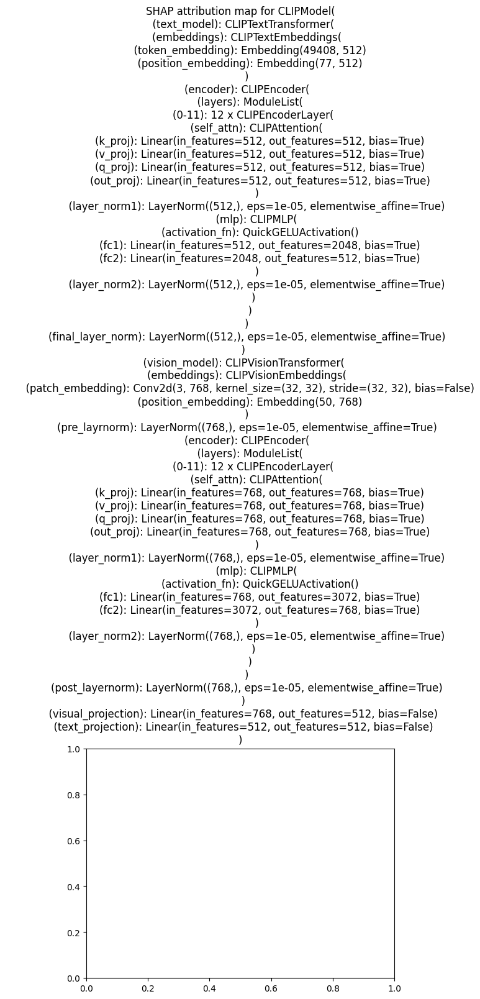

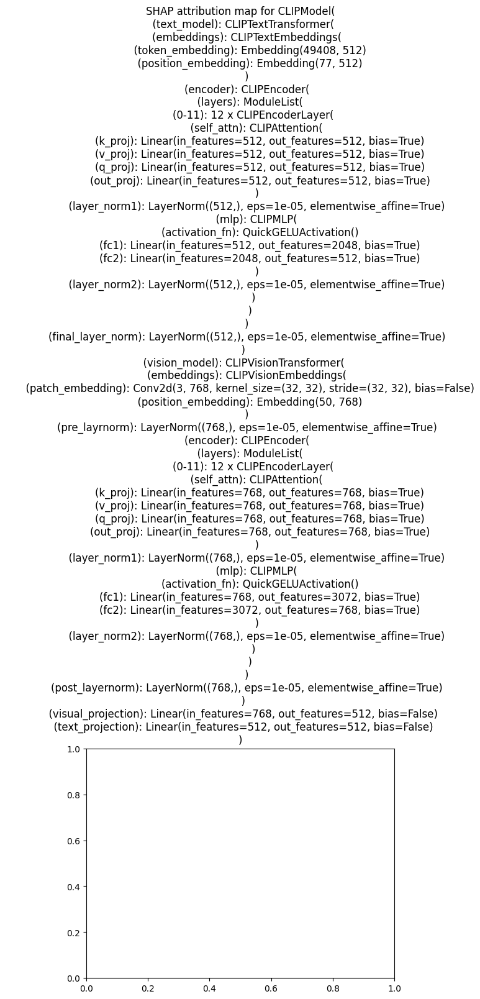

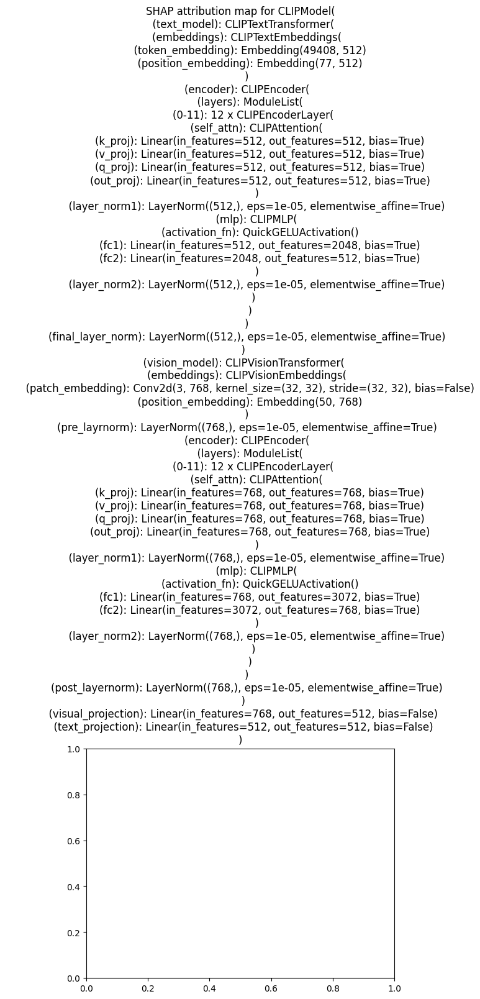

...

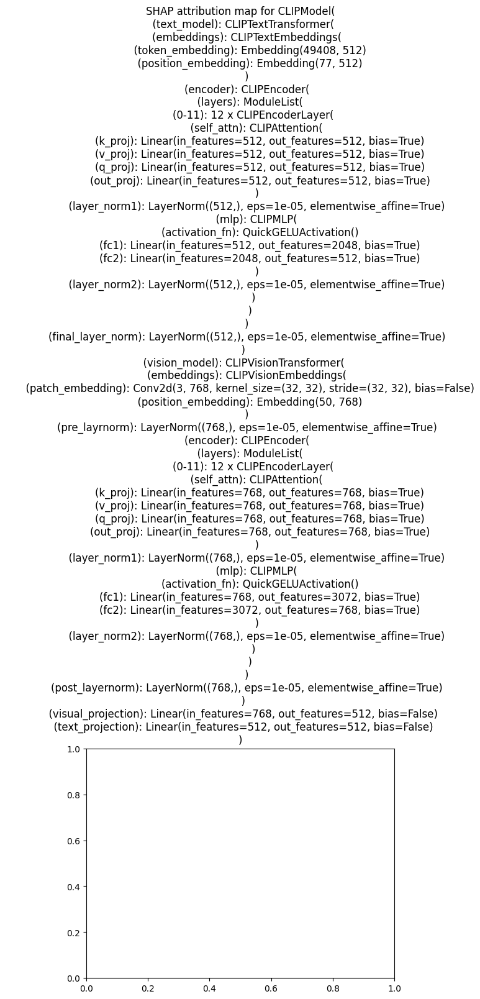

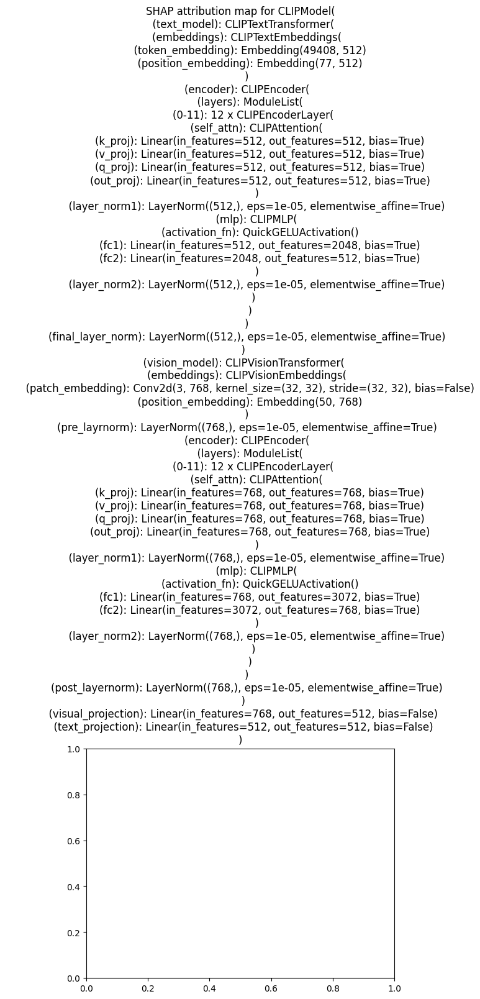

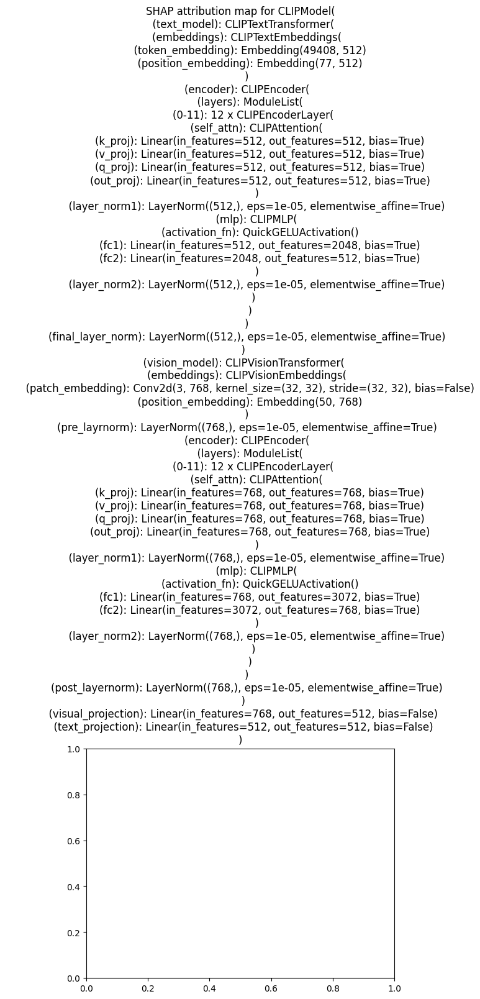

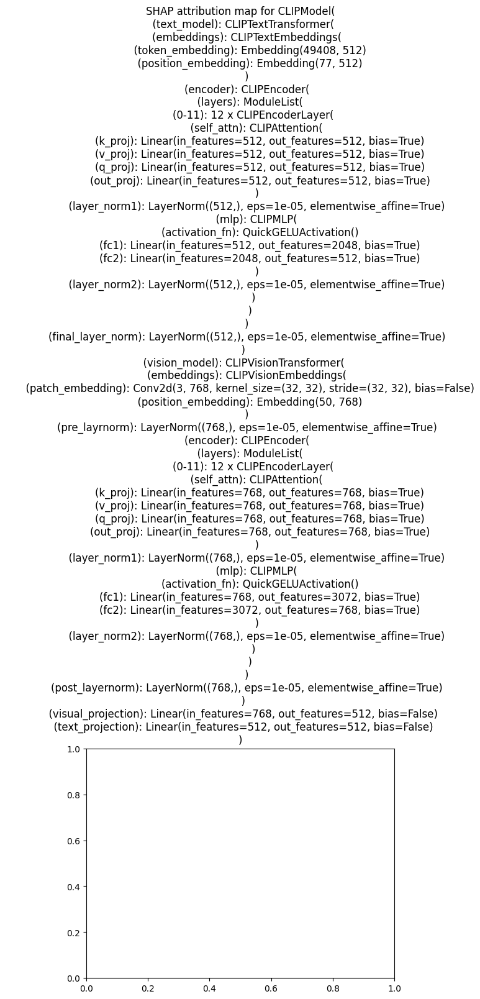

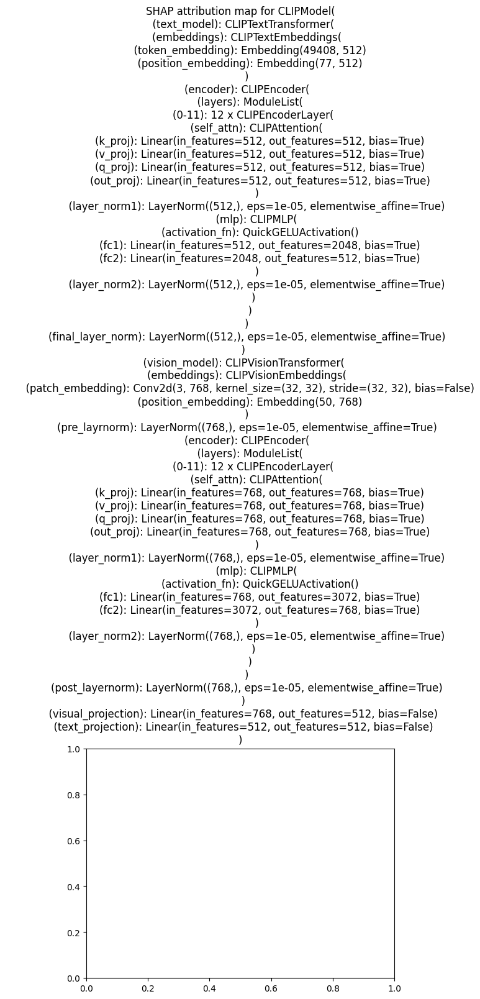

In [13]:

VERBOSE = False 
DISPLAY_PLOTS = False
EXPORT_PLOTS = True

output = defaultdict(list)

for index, row in stimuli_df.iterrows():

    # note that if index is not reset this will go 1 to 33 three times.
    print(f"Processing stimulus {index+1} out of {len(stimuli_df)}")

    # copy main characteristics
    for name in ["img_path", "caption", "foil", "linguistic_phenomena"]:
        output[name].append(row[name])

    # calcualte shap map
    try:

        shap_map, n_variants = shap_functions.generate_shap(row['img_path'], row['caption'], row['foil'],
                                                                prediction_function=model_predict,
                                                                model=model,
                                                                model_name=model_name,
                                                                verbose=VERBOSE,
                                                                plots=DISPLAY_PLOTS,
                                                                export_plots=EXPORT_PLOTS,
                                                                return_variant_count=True)
        
        output["model_shap_map"].append(shap_map)
        output['n_image_variants'].append(n_variants)
    except Exception as e:
         output['model_shap_map'].append("Error: "+str(e))
         print(e)
         output['n_image_variants'].append("Error")
    1
final_model_shap_df = pd.DataFrame.from_dict(output)
    

In [10]:
output

defaultdict(list,
            {'img_path': ['../../VALSE_data/images/v7w/v7w_2318073.jpg',
              '../../VALSE_data/images/v7w/v7w_2323857.jpg',
              '../../VALSE_data/images/v7w/v7w_2336798.jpg',
              '../../VALSE_data/images/v7w/v7w_2349587.jpg',
              '../../VALSE_data/images/v7w/v7w_2352298.jpg',
              '../../VALSE_data/images/v7w/v7w_2360434.jpg',
              '../../VALSE_data/images/v7w/v7w_2362476.jpg',
              '../../VALSE_data/images/v7w/v7w_2389519.jpg',
              '../../VALSE_data/images/v7w/v7w_2393355.jpg',
              '../../VALSE_data/images/v7w/v7w_2411942.jpg',
              '../../VALSE_data/images/v7w/v7w_2417412.jpg',
              '../../VALSE_data/images/swig/speaking_84.jpg',
              '../../VALSE_data/images/swig/tripping_125.jpg',
              '../../VALSE_data/images/swig/punching_28.jpg',
              '../../VALSE_data/images/swig/handcuffing_40.jpg',
              '../../VALSE_data/images/swig/car

In [ ]:
for key in output.keys():
    print(key, len(output[key]))

img_path 2
caption 2
foil 2
linguistic_phenomena 2
model_shap_map 2


### Export resulting dataframe

In [14]:
final_model_shap_df.to_pickle(f"xai_output/{model_name}_shap_maps.pickle")

### Find which if any stimuli threw an error

In [ ]:
final_model_shap_df[final_model_shap_df['model_shap_map'].apply(isinstance, args=(str,))]

,img_path,caption,foil,linguistic_phenomena,model_shap_map


In [ ]:
plt.imshow(final_clip_shap_df['clip_shap_map'][0])

NameError: name 'final_clip_shap_df' is not defined